<a href="https://colab.research.google.com/github/myconcordia/INSE6220/blob/main/Sample_Project_Classification_with_PyCaret.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Multiclass Classification with PyCaret**

Multiclass classification is a supervised machine learning technique where the goal is to classify instances into one of three or more classes. (Classifying instances into one of two classes is called Binary Classification).

**Install Pycaret**

In [1]:
# install slim version (default): if you get an error message, run it again
!pip install pycaret

In [2]:
#Run the below code in your notebook to check the installed version
from pycaret.utils import version
version()

'3.2.0'

**Import Libraries**

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")
import pandas as pd
plt.rcParams['figure.figsize'] = (7,5)

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [4]:
print("Pandas version: ", pd.__version__)
print("Seaborn version: ", sns.__version__)

Pandas version:  1.5.3
Seaborn version:  0.12.2


In [5]:
#read cvs file into dataframe
df = pd.read_csv('https://raw.githubusercontent.com/Tawhidahmedchetan/INSE6220_Project/main/WaterQuality.csv')
df.head(25)

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.040,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.010,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.040,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.040,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.030,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1
5,0.94,14.47,0.030,2.88,0.003,0.80,0.43,1.38,0.11,0.67,...,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02,1
6,2.36,5.6,0.010,1.35,0.004,1.28,0.62,1.88,0.33,0.13,...,0.021,18.60,1.78,0.007,45.34,2.84,0.10,0.24,0.08,0
7,3.93,19.87,0.040,0.66,0.001,6.22,0.10,1.86,0.86,0.16,...,0.197,13.65,1.81,0.001,53.35,7.24,0.08,0.08,0.07,0
8,0.60,24.58,0.010,0.71,0.005,3.14,0.77,1.45,0.98,0.35,...,0.167,14.66,1.84,0.004,23.43,4.99,0.08,0.25,0.08,1
9,0.22,16.76,0.020,1.37,0.007,6.40,0.49,0.82,1.24,0.83,...,0.109,4.79,1.46,0.010,30.42,0.08,0.03,0.31,0.01,1


In [6]:
# Remove'#NUM!' values
df.replace('#NUM!', np.nan, inplace=True)

In [7]:
#convert this dataset to float
df = df.astype('float64')

In [8]:
# Count the nan and drop them
df.isna().any(axis=1).sum()
df.dropna(inplace=True)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7996 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7996 non-null   float64
 1   ammonia      7996 non-null   float64
 2   arsenic      7996 non-null   float64
 3   barium       7996 non-null   float64
 4   cadmium      7996 non-null   float64
 5   chloramine   7996 non-null   float64
 6   chromium     7996 non-null   float64
 7   copper       7996 non-null   float64
 8   flouride     7996 non-null   float64
 9   bacteria     7996 non-null   float64
 10  viruses      7996 non-null   float64
 11  lead         7996 non-null   float64
 12  nitrates     7996 non-null   float64
 13  nitrites     7996 non-null   float64
 14  mercury      7996 non-null   float64
 15  perchlorate  7996 non-null   float64
 16  radium       7996 non-null   float64
 17  selenium     7996 non-null   float64
 18  silver       7996 non-null   float64
 19  uraniu

In [10]:
print("Dataset Shape", df.shape)

Dataset Shape (7996, 21)


In [11]:
print("Number of duplicated rows is: ", df.duplicated().sum())

Number of duplicated rows is:  0


In [12]:
print("Number of rows with NaNs is: ", df.isna().any(axis=1).sum())

Number of rows with NaNs is:  0


In [13]:
print("Dataset Shape", df.shape)

Dataset Shape (7996, 21)


**Exploratory Data Analysis**

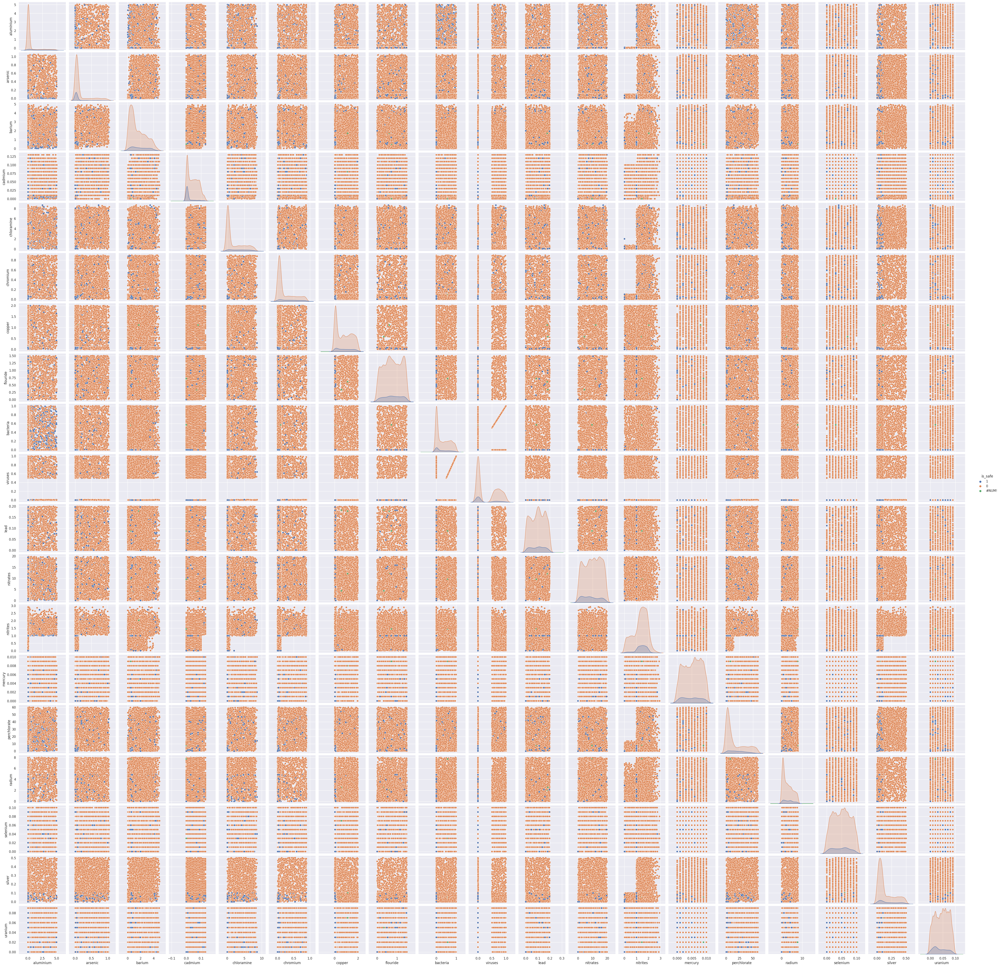

In [11]:
sns.pairplot(df, hue='is_safe')
plt.show()

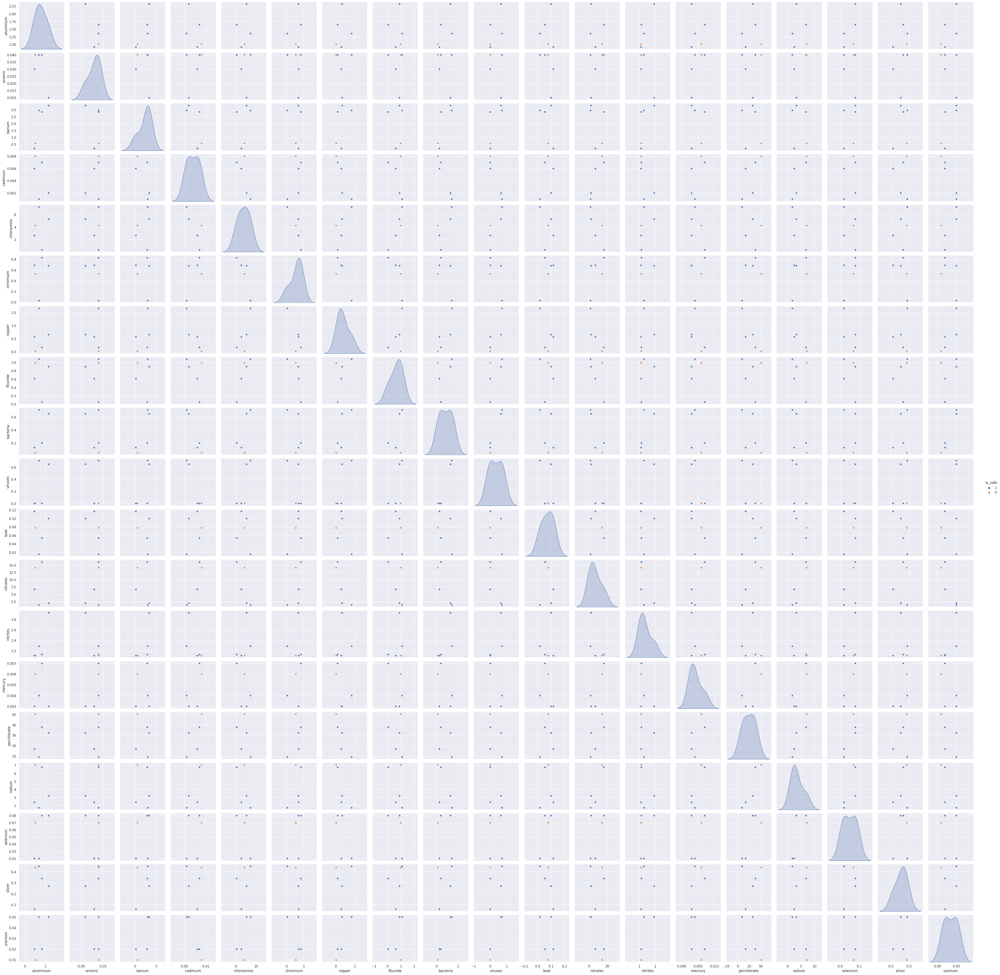

In [12]:
sns.pairplot(df[0:5], hue='is_safe')
plt.show()

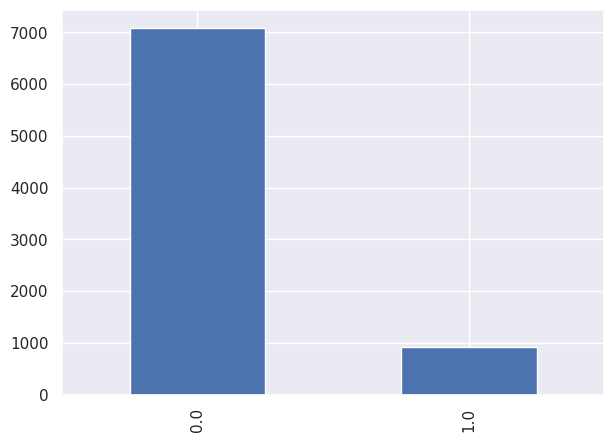

In [14]:
y = df['is_safe']
y.value_counts().plot(kind='bar')
plt.ylabel('')
plt.show()

**Data Matrix**

In [15]:
X = df.drop(columns=['is_safe'])
X.head(10)

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,0.000,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,0.650,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,0.003,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,0.710,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,0.001,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02
5,0.94,14.47,0.03,2.88,0.003,0.80,0.43,1.38,0.11,0.67,0.670,0.135,9.75,1.89,0.006,27.17,5.42,0.08,0.19,0.02
6,2.36,5.60,0.01,1.35,0.004,1.28,0.62,1.88,0.33,0.13,0.007,0.021,18.60,1.78,0.007,45.34,2.84,0.10,0.24,0.08
7,3.93,19.87,0.04,0.66,0.001,6.22,0.10,1.86,0.86,0.16,0.005,0.197,13.65,1.81,0.001,53.35,7.24,0.08,0.08,0.07
8,0.60,24.58,0.01,0.71,0.005,3.14,0.77,1.45,0.98,0.35,0.002,0.167,14.66,1.84,0.004,23.43,4.99,0.08,0.25,0.08
9,0.22,16.76,0.02,1.37,0.007,6.40,0.49,0.82,1.24,0.83,0.830,0.109,4.79,1.46,0.010,30.42,0.08,0.03,0.31,0.01


In [16]:
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
aluminium,7996.0,0.666396,1.265323,0.00,0.0400,0.070,0.2800,5.05
ammonia,7996.0,14.278212,8.878930,-0.08,6.5775,14.130,22.1325,29.84
arsenic,7996.0,0.161477,0.252632,0.00,0.0300,0.050,0.1000,1.05
barium,7996.0,1.567928,1.216227,0.00,0.5600,1.190,2.4825,4.94
cadmium,7996.0,0.042803,0.036049,0.00,0.0080,0.040,0.0700,0.13
chloramine,7996.0,2.177589,2.567210,0.00,0.1000,0.530,4.2400,8.68
chromium,7996.0,0.247300,0.270663,0.00,0.0500,0.090,0.4400,0.90
copper,7996.0,0.805940,0.653595,0.00,0.0900,0.750,1.3900,2.00
flouride,7996.0,0.771646,0.435423,0.00,0.4075,0.770,1.1600,1.50
bacteria,7996.0,0.319714,0.329497,0.00,0.0000,0.220,0.6100,1.00


**Standardize the Data**

In [17]:
Xs = StandardScaler().fit_transform(X)
Xcols = X.columns
X = pd.DataFrame(Xs)
X.columns = Xcols
X.head(10)

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium
0,0.777403,-0.585491,-0.480875,1.054205,-0.993241,-0.711941,2.152993,-0.973050,-1.657446,-0.363345,-0.869387,-0.781070,1.129767,-0.348629,0.609178,1.203362,1.661842,1.053694,1.338736,-0.917040
1,1.306945,0.775118,-0.599632,1.432447,-1.131948,1.208552,1.598765,-0.223303,0.294799,1.002460,0.849782,0.009785,-1.409197,1.046960,-0.739005,0.892977,0.124811,1.053694,0.851134,0.198023
2,0.271572,-0.029083,-0.480875,-0.812340,-0.965499,0.803417,1.044536,-1.202564,0.501507,-0.818614,-0.861452,-0.368450,0.783298,-0.383518,0.272132,1.911763,1.786699,0.706129,2.035310,-1.288728
3,0.548198,-0.332067,-0.480875,1.144654,-1.159690,1.968179,-0.802892,1.306793,0.708215,1.184567,1.008475,-1.434385,-1.517469,-0.069511,-0.401960,-0.415275,-0.516695,-1.031700,2.104968,0.198023
4,0.200439,1.132165,-0.520460,-1.124801,-1.020982,0.191820,1.635713,-0.361012,-0.371261,-0.575804,-0.866742,0.302058,-0.555658,-0.383518,-0.739005,0.024578,-0.219622,-1.031700,-0.611672,-0.917040
5,0.216246,0.021602,-0.520460,1.078873,-1.104207,-0.536643,0.675051,0.878366,-1.519641,1.063162,0.902680,0.611523,-0.012496,0.977180,0.272132,0.605207,1.076306,1.053694,0.293875,-0.917040
6,1.338559,-0.977455,-0.599632,-0.179195,-1.076465,-0.349658,1.377073,1.643414,-1.014354,-0.575804,-0.850872,-1.348423,1.584507,0.785287,0.609178,1.632473,-0.034489,1.748826,0.642162,1.313085
7,2.579427,0.629821,-0.480875,-0.746558,-1.159690,1.574731,-0.544252,1.612812,0.202928,-0.484750,-0.856162,1.677459,0.691268,0.837621,-1.413097,2.085330,1.859891,1.053694,-0.472357,0.941398
8,-0.052477,1.160324,-0.599632,-0.705445,-1.048724,0.374910,1.931302,0.985473,0.478539,0.091923,-0.864097,1.161683,0.873525,0.889956,-0.401960,0.393761,0.891174,1.053694,0.711819,1.313085
9,-0.352814,0.279532,-0.560046,-0.162749,-0.993241,1.644850,0.896742,0.021512,1.075697,1.548782,1.325860,0.164518,-0.907540,0.227051,1.620315,0.788950,-1.222782,-0.684134,1.129764,-1.288728


In [18]:
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
aluminium,7996.0,-1.421796e-16,1.000063,-0.526693,-0.495079,-0.471368,-0.305392,3.464632
ammonia,7996.0,1.706156e-16,1.000063,-1.617212,-0.867356,-0.016694,0.884654,1.752774
arsenic,7996.0,-5.687185e-17,1.000063,-0.639217,-0.520460,-0.441289,-0.243361,3.517278
barium,7996.0,0.000000e+00,1.000063,-1.289254,-0.828785,-0.310757,0.752022,2.772741
cadmium,7996.0,-3.270132e-16,1.000063,-1.187431,-0.965499,-0.077771,0.754475,2.418966
chloramine,7996.0,0.000000e+00,1.000063,-0.848285,-0.809330,-0.641822,0.803417,2.533030
chromium,7996.0,0.000000e+00,1.000063,-0.913738,-0.728995,-0.581200,0.711999,2.411633
copper,7996.0,-8.530778e-17,1.000063,-1.233166,-1.095458,-0.085594,0.893667,1.827026
flouride,7996.0,1.328491e-16,1.000063,-1.772284,-0.836355,-0.003780,0.891956,1.672854
bacteria,7996.0,5.687185e-17,1.000063,-0.970370,-0.970370,-0.302643,0.881055,2.064753


**Observations and variables**

In [27]:
observations = list(df.index)
variables = list(df.columns)

**Box and Whisker Plots**

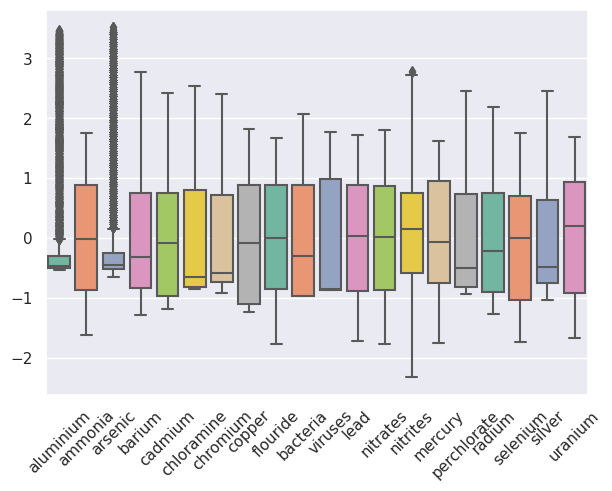

In [28]:
ax = plt.figure()
ax = sns.boxplot(data=X, orient="v", palette="Set2")
ax.set_xticklabels(ax.get_xticklabels(),rotation=45);

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


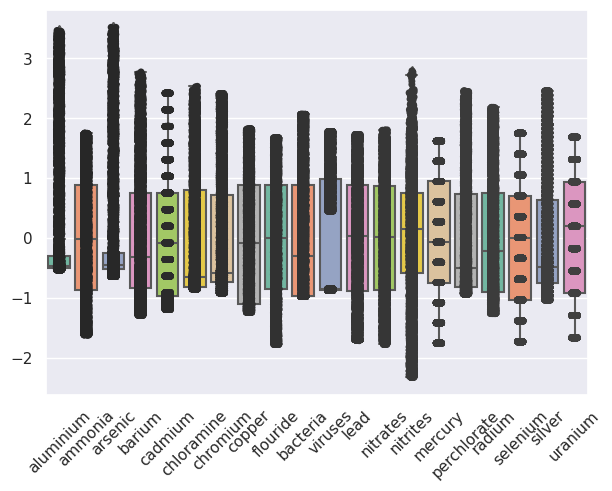

In [29]:
# Use swarmplot() or stripplot to show the datapoints on top of the boxes:
#plt. figure()
ax = plt.figure()
ax = sns.boxplot(data=X, orient="v", palette="Set2")
ax = sns.stripplot(data=X, color=".25")
ax.set_xticklabels(ax.get_xticklabels(),rotation=45);

**Correlation Matrix**

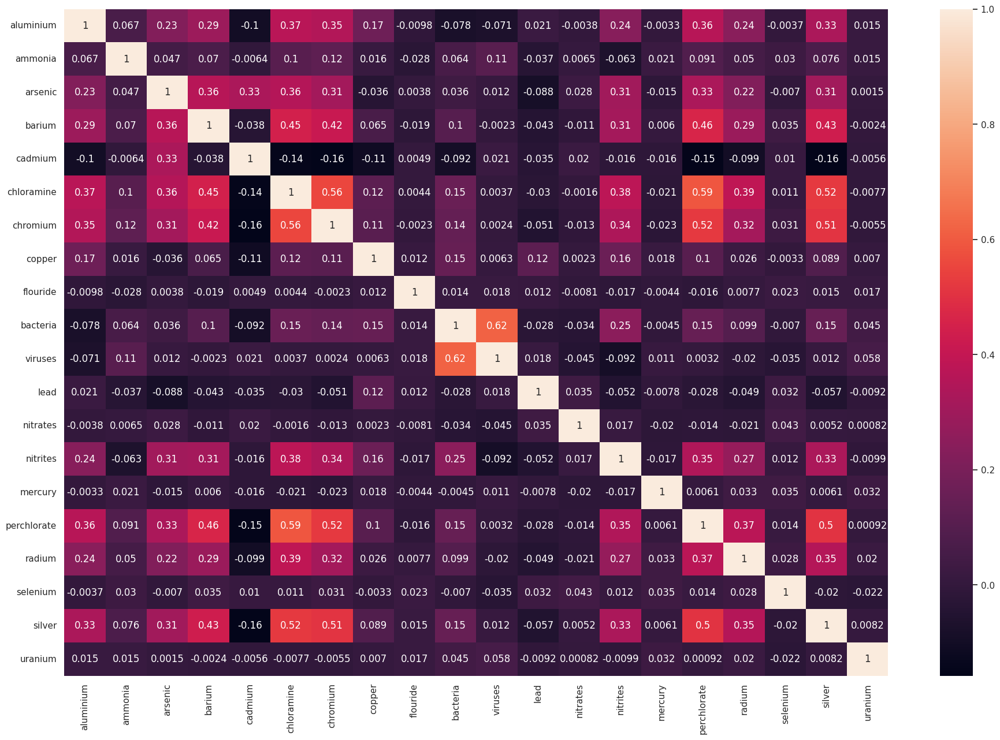

In [36]:
plt.figure(figsize=(23, 15))
sns.heatmap(X.corr(), annot=True)
plt.show()
# ax = sns.heatmap(X.corr(), cmap='RdYlGn_r', linewidths=0.9, annot=True, cbar=False, square=True)
# plt.yticks(rotation=0)
# ax.tick_params(labelbottom=False,labeltop=True)
# ax.set_xticklabels(ax.get_xticklabels(),rotation=0);

#X.corr().style.background_gradient(cmap='coolwarm').set_precision(2)
#sns.clustermap(X.corr(), annot=True, fmt='.2f')

##**Principal Component Analysis (PCA)**

Text(0, 0.5, '$Z_2$')

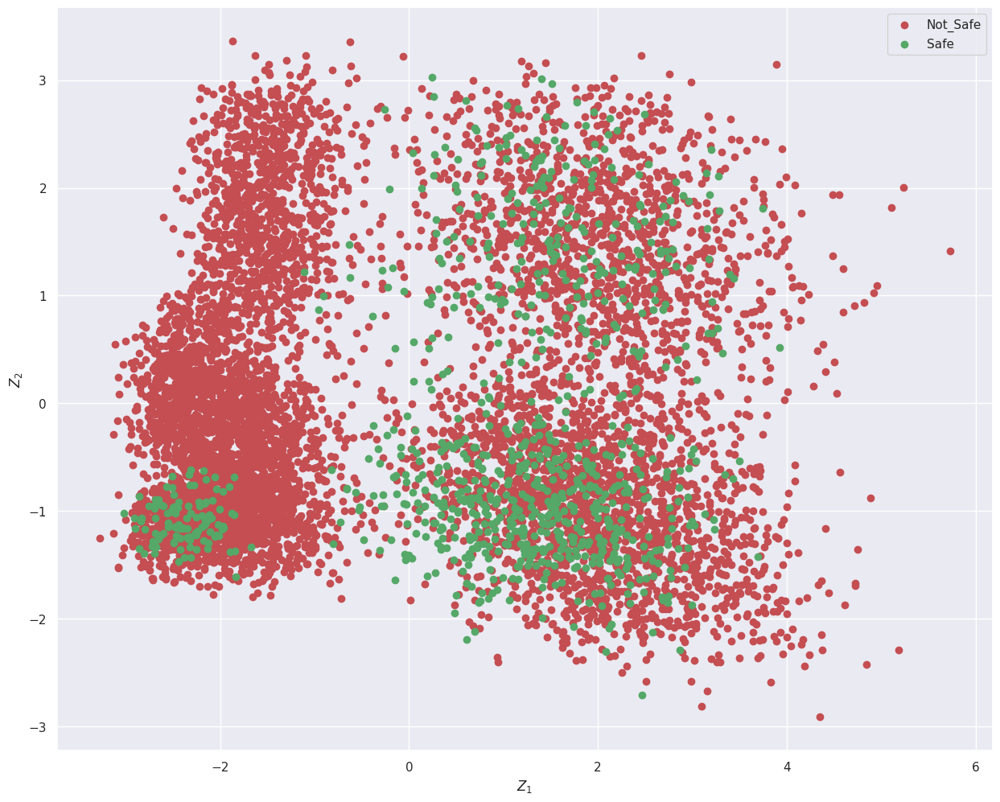

In [54]:
pca = PCA()
Z = pca.fit_transform(X)

# Not_safe->0,  Safe->1
not_safe = np.where(y == 0)
safe = np.where(y == 1)

plt.figure(figsize=(15, 12))

plt.scatter(Z[not_safe,0], Z[not_safe,1], c='r', label='Not_Safe')
plt.scatter(Z[safe,0], Z[safe,1], c='g', label='Safe')
plt.legend()
plt.xlabel('$Z_1$')
plt.ylabel('$Z_2$')

**Eigenvectors**

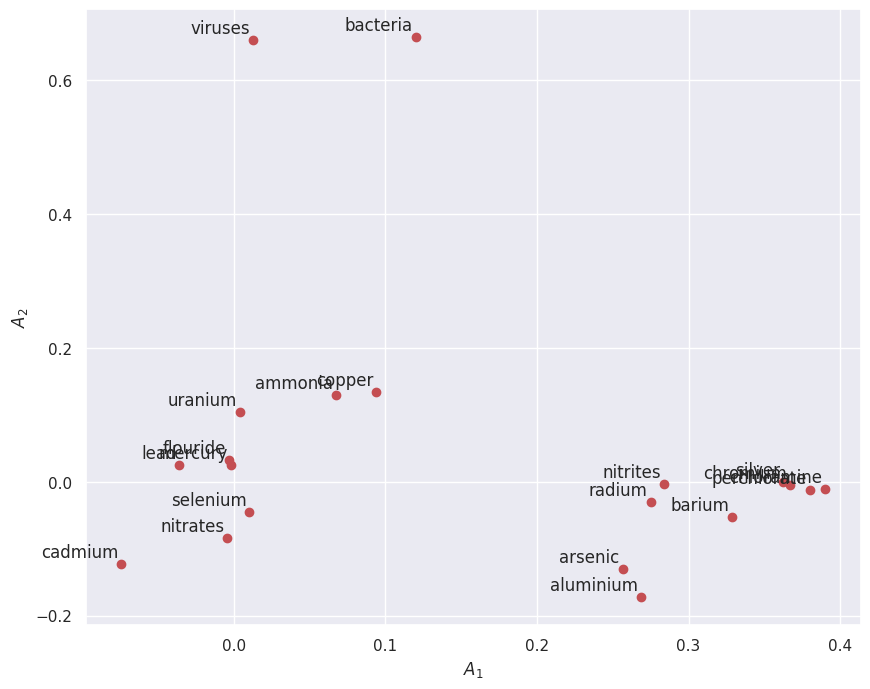

In [64]:
A = pca.components_.T
plt.figure(figsize=(10, 8))
plt.scatter(A[:,0],A[:,1],c='r')
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for label, x, y in zip(variables, A[:, 0], A[:, 1]):
  plt.annotate(label, xy=(x, y), xytext=(-2, 2), textcoords='offset points', ha='right', va='bottom')

/usr/local/lib/python3.10/dist-packages/matplotlib/collections.py:963: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


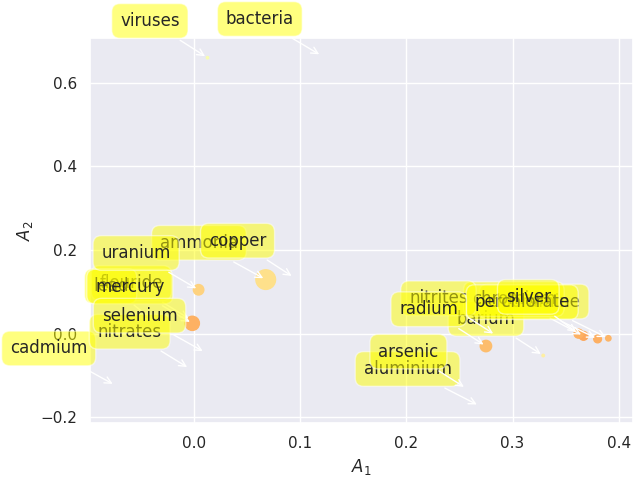

In [65]:
plt.scatter(A[:, 0],A[:, 1], marker='o', c=A[:, 2], s=A[:, 3]*500, cmap=plt.get_cmap('Spectral'))
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for label, x, y in zip(variables,A[:, 0],A[:, 1]):
  plt.annotate(label,xy=(x, y), xytext=(-20, 20),
      textcoords='offset points', ha='right', va='bottom',
      bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
      arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

**Scree plot**

Text(0, 0.5, 'Explained variance')

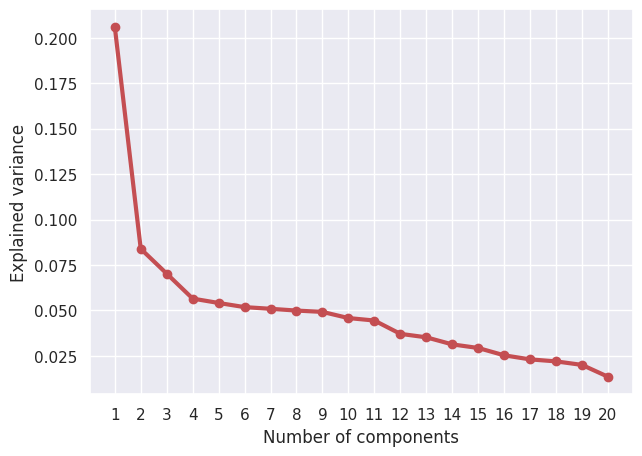

In [66]:
#Eigenvalues
Lambda = pca.explained_variance_

#Scree plot
x = np.arange(len(Lambda)) + 1
plt.plot(x,Lambda/sum(Lambda), 'ro-', lw=3)
plt.xticks(x, [""+str(i) for i in x], rotation=0)
plt.xlabel('Number of components')
plt.ylabel('Explained variance')

**Explained Variance**

Text(0, 0.5, 'Cumulative explained variance')

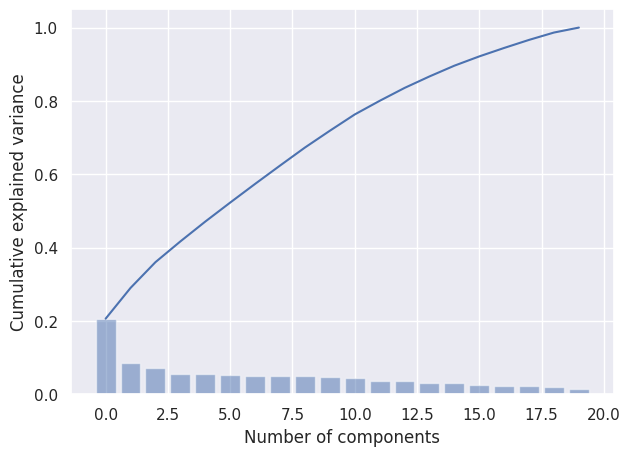

In [67]:
ell = pca.explained_variance_ratio_
ind = np.arange(len(ell))
plt.bar(ind, ell, align='center', alpha=0.5)
plt.plot(np.cumsum(ell))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')

**Biplot**

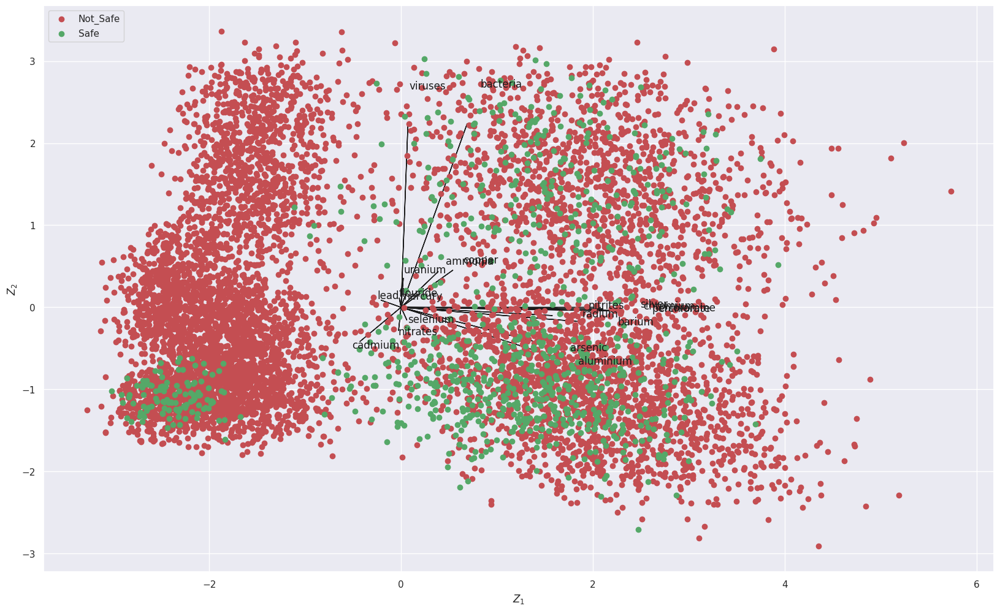

In [72]:
# 0,1 denote PC1 and PC2; change values for other PCs
A1 = A[:,0]
A2 = A[:,1]
Z1 = Z[:,0]
Z2 = Z[:,1]

plt.figure(figsize= (20, 12))
plt.xlabel('$Z_1$')
plt.ylabel('$Z_2$')
for i in range(len(A1)):
# arrows project features as vectors onto PC axes
  plt.arrow(0, 0, A1[i]*max(Z1), A2[i]*max(Z2), color='k', width=0.0005, head_width=0.0025)
  plt.text(A1[i]*max(Z1)*1.2, A2[i]*max(Z2)*1.2,variables[i], color='k')

plt.scatter(Z[not_safe,0], Z[not_safe,1], c='r', label='Not_Safe')
plt.scatter(Z[safe,0], Z[safe,1], c='g', label='Safe')

plt.legend(loc='upper left')

##**Using PCA Library**

In [73]:
!pip install pca

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 2.4 MB/s eta 0:00:00


In [76]:
from pca import pca
# Initialize and keep all PCs
model = pca()
# Fit transform
out = model.fit_transform(X)

[pca] >Extracting column labels from dataframe.
[pca] >Extracting row labels from dataframe.
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [20] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [18] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [20] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[18]
[pca] >Multiple test correction applied for Hotelling T2 test: [fdr_bh]
[pca] >Outlier detection using SPE/DmodX with n_std=[3]


**Principal Components**

In [77]:
out['PC']

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18
0,2.167658,-1.390492,-0.904675,1.442392,-0.588738,0.897288,1.210630,1.441995,-1.462521,-0.040824,-0.890603,-0.384150,0.883849,-0.602848,-0.049369,0.761552,-1.148159,-0.732914
1,2.970856,1.255835,-0.969101,0.772716,-0.078181,0.208509,0.747966,-0.497896,0.813821,-1.458777,0.329847,-0.720080,-0.148411,0.953684,0.722783,0.044128,-0.420661,-0.501818
2,2.083177,-1.409226,-1.086877,1.441028,-0.430279,0.329753,2.007557,-0.335940,-0.479345,0.793969,-1.112402,0.642487,0.605251,-0.103134,-1.502373,0.473653,0.807359,-0.585912
3,1.705439,1.810527,-0.869402,0.658277,1.947159,-0.412658,-0.061819,-0.520686,0.655571,0.316104,1.110270,-1.197061,0.111364,-0.839792,0.610826,1.109920,1.309307,0.414616
4,-0.137774,-0.667038,-1.256153,1.098624,0.461757,1.605855,-0.311959,-0.592178,0.866663,0.297176,0.012265,0.395393,-0.450147,0.891761,-1.073225,-0.547462,-1.153147,0.061757
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7991,-1.895960,-1.377153,-0.495409,-0.947170,-1.180632,-0.491738,1.629750,-0.792455,0.098341,-0.246673,-1.451244,-0.142248,-0.351122,0.101984,0.855983,0.136323,-0.093678,-0.085153
7992,-1.968274,-0.817746,-0.128851,1.414017,-0.664203,-0.388870,1.197798,-2.380015,-0.735290,-1.075218,1.350257,-0.061610,-0.469811,0.624416,0.260448,0.240621,0.474217,0.576338
7993,-2.010399,-1.227654,-0.554167,-0.603401,1.248466,0.823504,-0.317455,-1.776783,-0.987419,0.105160,-1.780688,1.396970,0.220676,0.002943,0.284866,-0.011831,-0.391580,0.081292
7994,-2.390703,-1.160668,-0.248392,2.338874,2.734600,2.639177,0.007913,0.273728,0.943495,-0.367596,0.009293,-1.240676,0.123520,-1.097141,0.576150,-0.583142,0.007947,0.749828


**Scatter plot**

[scatterd] >INFO> Create scatterplot


[pca]> [WARNING]: De parameter <label> is deprecated and will not be supported in future version.


(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': '18 Principal Components explain [98.64%] of the variance'}, xlabel='PC1 (20.6% expl.var)', ylabel='PC2 (8.39% expl.var)'>)

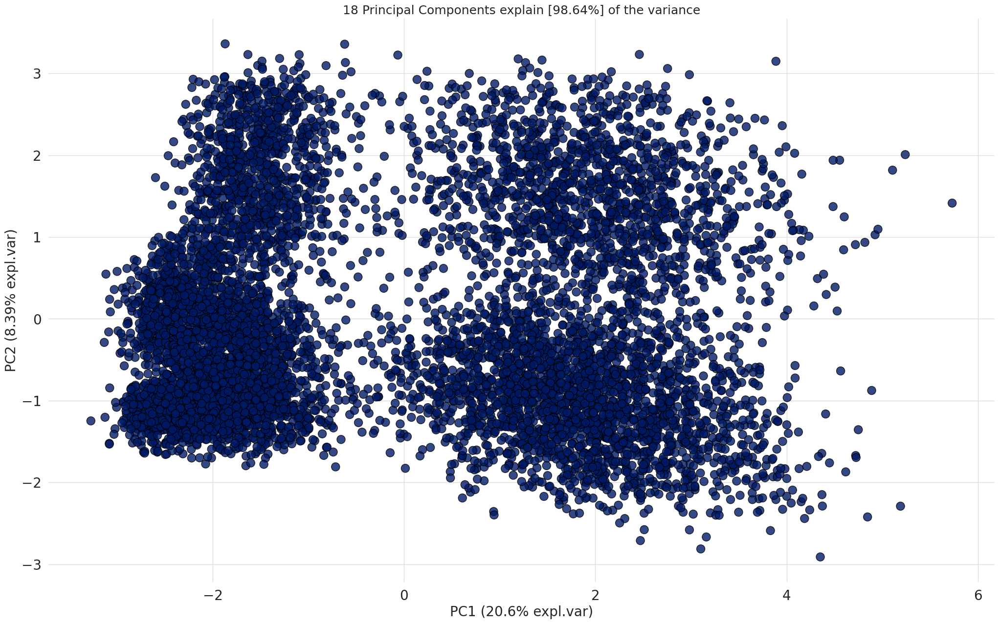

In [78]:
model.scatter(label=True, legend=False)

**Eigenvectors**

In [79]:
A = out['loadings'].T

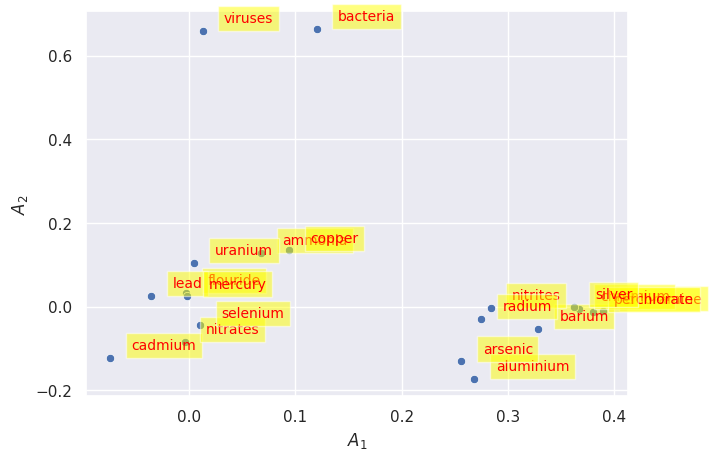

In [80]:
sns.scatterplot(data=A, x="PC1", y="PC2")
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for i in range(A.shape[0]):
 plt.text(x=A.PC1[i]+0.02,y=A.PC2[i]+0.02, s=variables[i],
          fontdict=dict(color='red',size=10),
          bbox=dict(facecolor='yellow',alpha=0.5))

**Scree Plot**

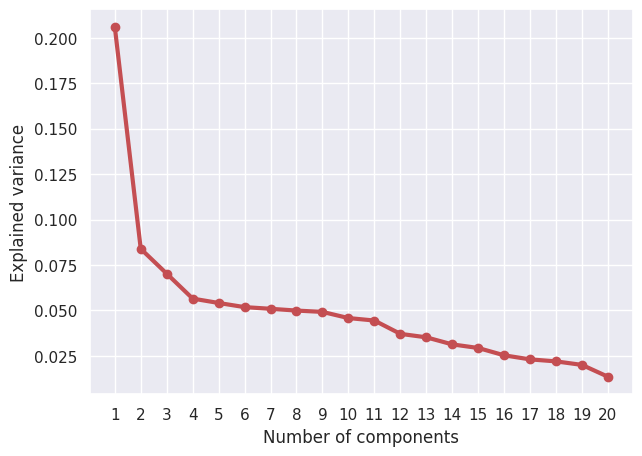

In [81]:
VR = out['variance_ratio']
x = np.arange(len(VR)) + 1
plt.plot(x, VR, 'ro-', lw=3)
plt.xticks(x, [""+str(i) for i in x], rotation=0)
plt.xlabel('Number of components')
plt.ylabel('Explained variance')
plt.show()

**Explained Variance Plot**

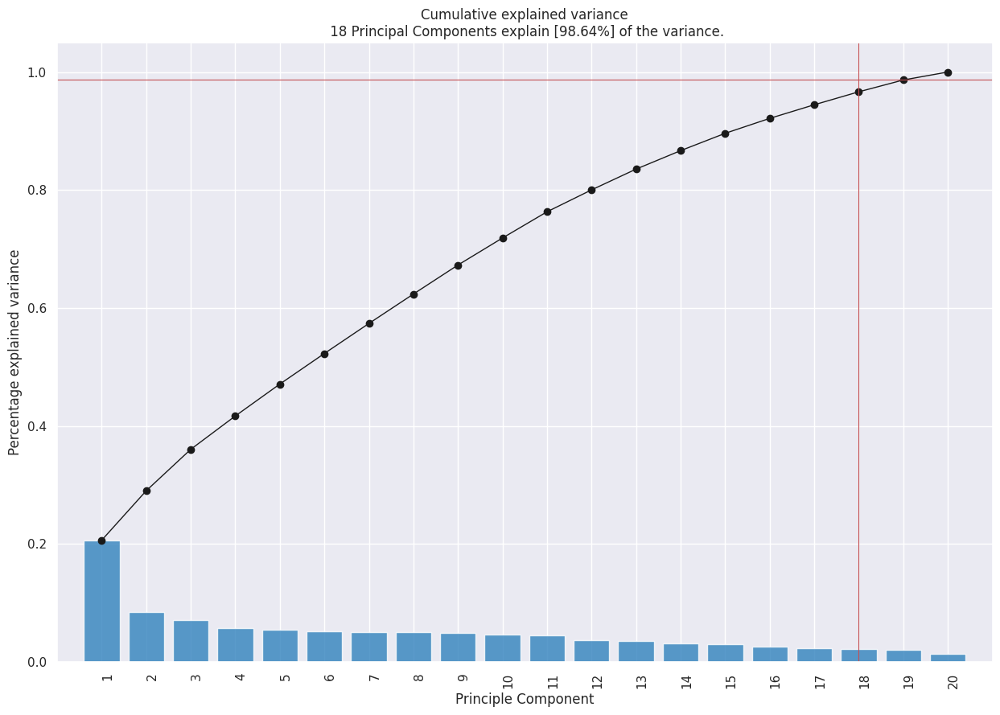

In [82]:
model.plot();

**Biplot**

[scatterd] >INFO> Create scatterplot


[pca]> [WARNING]: De parameter <label> is deprecated and will not be supported in future version.
[pca] >Plot PC1 vs PC2 with loadings.


(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': '18 Principal Components explain [98.64%] of the variance'}, xlabel='PC1 (20.6% expl.var)', ylabel='PC2 (8.39% expl.var)'>)

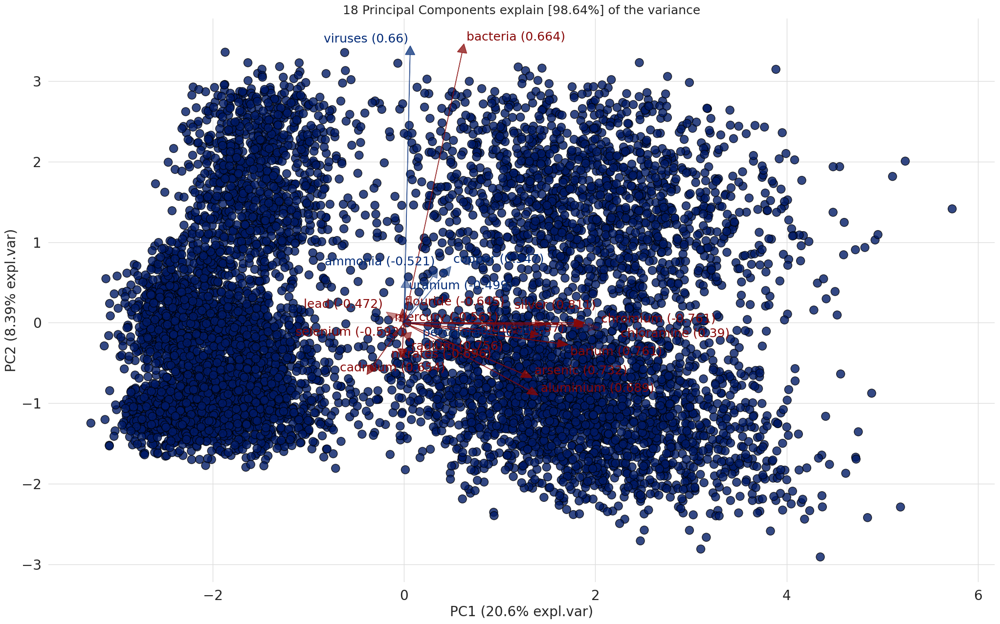

In [83]:
model.biplot(label=False, legend=False)

[scatterd] >INFO> Create scatterplot


[pca] >Plot PC1 vs PC2 vs PC3 with loadings.


(<Figure size 3000x2500 with 1 Axes>,
 <Axes3D: title={'center': '18 Principal Components explain [98.64%] of the variance'}, xlabel='PC1 (20.6% expl.var)', ylabel='PC2 (8.39% expl.var)', zlabel='PC3 (7.02% expl.var)'>)

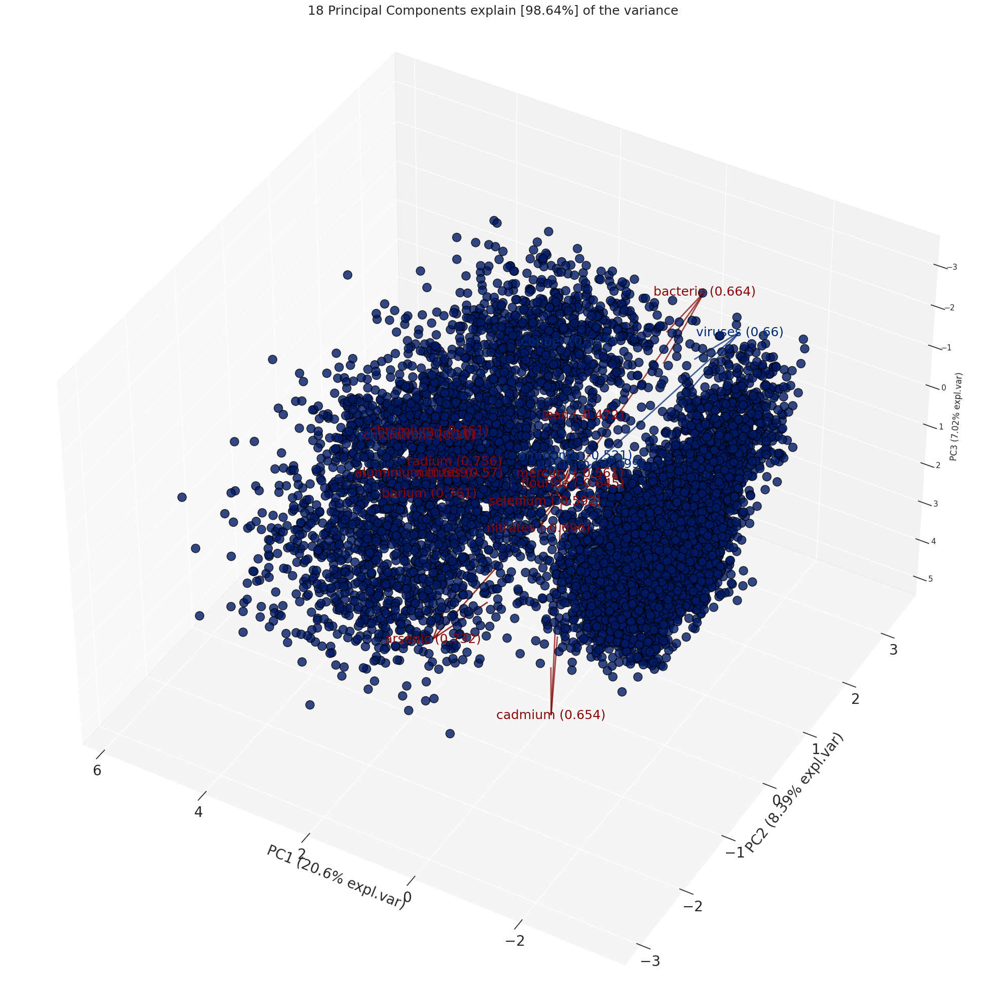

In [84]:
model.biplot3d(legend=False)

#**Classification**

**Using PyCaret**

PyCaret uses interactive plotting ability. In order to render interactive plots in Google Colab, run the below line of code in your colab notebook.

In [93]:
# For Google Colab only
# from pycaret.utils import enable_colab
# enable_colab()

In order to demonstrate the predict_model() function on unseen data, a sample of 21 observations has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these 21 records were not available at the time when the machine learning experiment was performed.

In [19]:
data = df.sample(frac=0.8, random_state=786)
data_unseen = df.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (6397, 21)
Unseen Data For Predictions: (1599, 21)


**Setting up the Environment in PyCaret**

The setup() function initializes the environment in pycaret and creates the transformation pipeline to prepare the data for modeling and deployment. setup() must be called before executing any other function in pycaret. It takes two mandatory parameters: a pandas dataframe and the name of the target column. All other parameters are optional and are used to customize the pre-processing pipeline (we will see them in later tutorials).

When setup() is executed, PyCaret's inference algorithm will automatically infer the data types for all features based on certain properties. The data type should be inferred correctly but this is not always the case. To account for this, PyCaret displays a table containing the features and their inferred data types after setup() is executed. If all of the data types are correctly identified enter can be pressed to continue or quit can be typed to end the expriment. Ensuring that the data types are correct is of fundamental importance in PyCaret as it automatically performs a few pre-processing tasks which are imperative to any machine learning experiment. These tasks are performed differently for each data type which means it is very important for them to be correctly configured.

In [20]:
from pycaret.classification import *
clf = setup(data=data, target='is_safe', train_size=0.7, session_id=123)

,Description,Value
0,Session id,123
1,Target,is_safe
2,Target type,Binary
3,Original data shape,"(6397, 21)"
4,Transformed data shape,"(6397, 21)"
5,Transformed train set shape,"(4477, 21)"
6,Transformed test set shape,"(1920, 21)"
7,Numeric features,20
8,Preprocess,True
9,Imputation type,simple


Once the setup has been succesfully executed it prints the information grid which contains several important pieces of information. Most of the information is related to the pre-processing pipeline which is constructed when setup() is executed. The majority of these features are out of scope for the purposes of this tutorial however a few important things to note at this stage include:

* **session_id** : A pseduo-random number distributed as a seed in all functions for later reproducibility. If no session_id is passed, a random number is automatically generated that is distributed to all functions. In this experiment, the session_id is set as 123 for later reproducibility.

* **Target Type** : Binary or Multiclass. The Target type is automatically detected and shown. There is no difference in how the experiment is performed for Binary or Multiclass problems. All functionalities are identical.

* **Label Encoded** : When the Target variable is of type string (i.e. 'Yes' or 'No') instead of 1 or 0, it automatically encodes the label into 1 and 0 and displays the mapping (0 : No, 1 : Yes) for reference.

* **Original Data** : Displays the original shape of the dataset. In this experiment (189, 8) means 189 samples and 8 features including the class column.

* **Missing Values** : When there are missing values in the original data this will show as True. For this experiment there are no missing values in the dataset.

* **Numeric Features** : The number of features inferred as numeric. In this dataset, 7 out of 8 features are inferred as numeric.

* **Categorical Features** : The number of features inferred as categorical. In this dataset, there are no categorical features.

* **Transformed Train Set** : Displays the shape of the transformed training set. Notice that the original shape of (189, 8) is transformed into (132, 7) for the transformed train set.

* **Transformed Test Set** : Displays the shape of the transformed test/hold-out set. There are 57 samples in test/hold-out set. This split is based on the default value of 70/30 that can be changed using the train_size parameter in setup.

Notice how a few tasks that are imperative to perform modeling are automatically handled such as missing value imputation, categorical encoding etc. Most of the parameters in setup() are optional and used for customizing the pre-processing pipeline.

**Comparing All Models**

In [21]:
 #show the best model and their statistics
 best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
xgboost,Extreme Gradient Boosting,0.9647,0.9856,0.7794,0.9079,0.8362,0.8167,0.8211,0.1730
lightgbm,Light Gradient Boosting Machine,0.9629,0.9864,0.7716,0.8988,0.8278,0.8072,0.8117,0.9270
gbc,Gradient Boosting Classifier,0.9538,0.9811,0.6828,0.8967,0.7717,0.7467,0.7572,1.1780
rf,Random Forest Classifier,0.9515,0.9753,0.6364,0.9192,0.7511,0.7253,0.7409,0.7130
dt,Decision Tree Classifier,0.9513,0.8833,0.7948,0.7885,0.7896,0.7621,0.7634,0.0460
et,Extra Trees Classifier,0.9305,0.9521,0.4643,0.8768,0.6047,0.5708,0.6067,0.3140
ada,Ada Boost Classifier,0.9281,0.9314,0.5436,0.7700,0.6333,0.5950,0.6082,0.2800
lr,Logistic Regression,0.9015,0.8571,0.2979,0.6620,0.4077,0.3630,0.3988,0.6180
lda,Linear Discriminant Analysis,0.8975,0.8642,0.4315,0.5762,0.4907,0.4355,0.4424,0.0350
ridge,Ridge Classifier,0.8937,0.0000,0.1723,0.6411,0.2683,0.2323,0.2922,0.0380


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [22]:
best_model

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)

**Create a Model**

create_model is the most granular function in PyCaret and is often the foundation behind most of the PyCaret functionalities. As the name suggests this function trains and evaluates a model using cross validation that can be set with fold parameter. The output prints a score grid that shows Accuracy, Recall, Precision, F1, Kappa and MCC by fold.

For the remaining part of this tutorial, we will work with the below models as our candidate models. The selections are for illustration purposes only and do not necessarily mean they are the top performing or ideal for this type of data.

* Decision Tree Classifier ('dt')
* K Neighbors Classifier ('knn')
* Logistic Regression ('lr')

There are many classifiers available in the model library of PyCaret. Please view the create_model() docstring for the list of all available models.

**Create Decision Tree Classifier**

In [23]:
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9754,0.9527,0.9231,0.8727,0.8972,0.8833,0.8837
1,0.9442,0.9016,0.8462,0.7213,0.7788,0.7471,0.7502
2,0.9487,0.8457,0.7115,0.8222,0.7629,0.7343,0.7367
3,0.9665,0.9309,0.8846,0.8364,0.8598,0.8408,0.8412
4,0.9464,0.8695,0.7692,0.7692,0.7692,0.7389,0.7389
5,0.9487,0.8707,0.7692,0.7843,0.7767,0.7477,0.7477
6,0.9531,0.8649,0.7500,0.8298,0.7879,0.7616,0.7628
7,0.9485,0.8428,0.7059,0.8182,0.7579,0.7293,0.7318
8,0.9284,0.8400,0.7255,0.6727,0.6981,0.6576,0.6582


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [24]:
#trained model object is stored in the variable 'dt'.
dt

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')

**Tune a Model:** How to automatically tune the hyper-parameters of a multiclass model. When a model is created using the create_model() function it uses the default hyperparameters. In order to tune hyperparameters, the tune_model() function is used. The tune_model() function is a random grid search of hyperparameters over a pre-defined search space. By default, it is set to optimize Accuracy but this can be changed using optimize parameter. This function automatically tunes the hyperparameters of a model on a pre-defined search space and scores it using stratified cross validation. The output prints a score grid that shows Accuracy, AUC, Recall, Precision, F1 and Kappa by fold.

**Tune Decision Tree Model**

In [25]:
tuned_dt = tune_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9688,0.9723,0.8269,0.8958,0.8600,0.8424,0.8433
1,0.9531,0.9496,0.7885,0.8039,0.7961,0.7696,0.7697
2,0.9464,0.9389,0.7692,0.7692,0.7692,0.7389,0.7389
3,0.9509,0.9509,0.7692,0.8000,0.7843,0.7566,0.7568
4,0.9643,0.9865,0.7692,0.9091,0.8333,0.8135,0.8170
5,0.9754,0.9701,0.8462,0.9362,0.8889,0.8751,0.8765
6,0.9598,0.9446,0.7500,0.8864,0.8125,0.7902,0.7936
7,0.9463,0.9707,0.6667,0.8293,0.7391,0.7096,0.7149
8,0.9642,0.9554,0.7255,0.9487,0.8222,0.8027,0.8116


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [26]:
#tuned model object is stored in the variable 'tuned_dt'.
tuned_dt

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=6, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0.002, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')

**Evaluate Decision Tree Model**

In [125]:
!pip install statsmodels --upgrade

How to analyze model performance using various plots

In [28]:
evaluate_model(tuned_dt)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

**Create K Neighbors Model**

In [29]:
knn = create_model('knn')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8705,0.7325,0.0769,0.2857,0.1212,0.0757,0.0951
1,0.8527,0.6768,0.1346,0.2500,0.1750,0.1020,0.1080
2,0.8638,0.6982,0.0769,0.2353,0.1159,0.0623,0.0739
3,0.8772,0.7456,0.1154,0.4000,0.1791,0.1341,0.1650
4,0.8906,0.7044,0.1731,0.6000,0.2687,0.2286,0.2812
5,0.8862,0.7610,0.1731,0.5294,0.2609,0.2160,0.2563
6,0.8728,0.6795,0.0577,0.2727,0.0952,0.0570,0.0776
7,0.8904,0.7049,0.1176,0.6000,0.1967,0.1655,0.2312
8,0.8725,0.7303,0.1176,0.3333,0.1739,0.1216,0.1413


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

**Tune K Neighbors Model**

In [30]:
tuned_knn = tune_model(knn, custom_grid = {'n_neighbors' : np.arange(0,50,1)})

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8817,0.8176,0.0000,0.0000,0.0000,-0.0044,-0.0171
1,0.8839,0.7827,0.0000,0.0000,0.0000,0.0000,0.0000
2,0.8817,0.7612,0.0000,0.0000,0.0000,-0.0044,-0.0171
3,0.8839,0.7746,0.0000,0.0000,0.0000,0.0000,0.0000
4,0.8839,0.7726,0.0000,0.0000,0.0000,0.0000,0.0000
5,0.8839,0.8361,0.0000,0.0000,0.0000,0.0000,0.0000
6,0.8839,0.8174,0.0000,0.0000,0.0000,0.0000,0.0000
7,0.8859,0.7844,0.0000,0.0000,0.0000,0.0000,0.0000
8,0.8881,0.8024,0.0196,1.0000,0.0385,0.0342,0.1319


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


**Evaluate K Neighbors Model**

In [31]:
evaluate_model(tuned_knn)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

**Create Logistic Regression Model**

In [32]:
lr = create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8906,0.8515,0.2692,0.5600,0.3636,0.3118,0.3369
1,0.9085,0.8592,0.3462,0.7200,0.4675,0.4241,0.4584
2,0.8951,0.8226,0.2308,0.6316,0.3380,0.2942,0.3387
3,0.8996,0.8980,0.3462,0.6207,0.4444,0.3941,0.4145
4,0.8884,0.7963,0.2500,0.5417,0.3421,0.2901,0.3161
5,0.9241,0.9133,0.4615,0.8000,0.5854,0.5469,0.5720
6,0.8951,0.8422,0.1923,0.6667,0.2985,0.2601,0.3199
7,0.9128,0.8577,0.3137,0.8000,0.4507,0.4130,0.4669
8,0.8926,0.8778,0.2353,0.5714,0.3333,0.2858,0.3194


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

**Tune Logistic Regression Model**

In [33]:
tuned_lr = tune_model(lr)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8973,0.8563,0.2885,0.6250,0.3947,0.3469,0.3780
1,0.9107,0.8632,0.3654,0.7308,0.4872,0.4442,0.4763
2,0.9018,0.8293,0.2885,0.6818,0.4054,0.3613,0.4014
3,0.9062,0.9061,0.4231,0.6471,0.5116,0.4623,0.4751
4,0.8973,0.8079,0.2692,0.6364,0.3784,0.3323,0.3691
5,0.9219,0.9115,0.4808,0.7576,0.5882,0.5474,0.5648
6,0.8973,0.8497,0.2115,0.6875,0.3235,0.2844,0.3433
7,0.9150,0.8650,0.3529,0.7826,0.4865,0.4473,0.4897
8,0.8993,0.8896,0.3137,0.6154,0.4156,0.3668,0.3918


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


**Evaluate Logistic Regression Model**

In [34]:
evaluate_model(tuned_lr)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

**Create Random Forest Model**

In [35]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9576,0.9937,0.6731,0.9459,0.7865,0.7637,0.7774
1,0.9397,0.9741,0.5962,0.8378,0.6966,0.6642,0.6761
2,0.9442,0.9795,0.5962,0.8857,0.7126,0.6830,0.6995
3,0.9643,0.9699,0.7308,0.9500,0.8261,0.8066,0.8152
4,0.9442,0.9723,0.5962,0.8857,0.7126,0.6830,0.6995
5,0.9554,0.9798,0.6731,0.9211,0.7778,0.7536,0.7651
6,0.9487,0.9761,0.5769,0.9677,0.7229,0.6966,0.7250
7,0.9463,0.9598,0.5882,0.9091,0.7143,0.6862,0.7060
8,0.9530,0.9689,0.6275,0.9412,0.7529,0.7281,0.7464


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

**Tune Random Forest Model**

In [36]:
tuned_rf = tune_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9688,0.9743,0.8077,0.9130,0.8571,0.8397,0.8417
1,0.9442,0.9562,0.6731,0.8140,0.7368,0.7059,0.7099
2,0.9442,0.9405,0.7115,0.7872,0.7475,0.7162,0.7174
3,0.9509,0.9575,0.7692,0.8000,0.7843,0.7566,0.7568
4,0.9621,0.9764,0.7308,0.9268,0.8172,0.7964,0.8034
5,0.9598,0.9633,0.7500,0.8864,0.8125,0.7902,0.7936
6,0.9531,0.9750,0.6923,0.8780,0.7742,0.7484,0.7550
7,0.9396,0.9584,0.5882,0.8333,0.6897,0.6573,0.6695
8,0.9530,0.9418,0.7255,0.8409,0.7789,0.7528,0.7554


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


**Evaluate Random Forest Model**

In [37]:
evaluate_model(tuned_rf)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

#**Tune the Best Model**

In [38]:
# Tune hyperparameters with scikit-learn (default)
tuned_best_model = tune_model(best_model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9643,0.9914,0.9038,0.8103,0.8545,0.8343,0.8359
1,0.9420,0.9828,0.9231,0.6857,0.7869,0.7541,0.7653
2,0.9554,0.9866,0.8654,0.7759,0.8182,0.7928,0.7944
3,0.9621,0.9814,0.9231,0.7869,0.8496,0.8280,0.8315
4,0.9621,0.9884,0.9038,0.7966,0.8468,0.8253,0.8274
5,0.9420,0.9853,0.8462,0.7097,0.7719,0.7390,0.7427
6,0.9598,0.9865,0.8077,0.8400,0.8235,0.8009,0.8011
7,0.9597,0.9836,0.8431,0.8113,0.8269,0.8041,0.8043
8,0.9485,0.9746,0.8431,0.7414,0.7890,0.7598,0.7619


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [39]:
tuned_best_model

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)

**Evaluate the Best Model**

One way to analyze the performance of models is to use the evaluate_model() function which displays a user interface for all of the available plots for a given model. It internally uses the plot_model() function.

In [40]:
evaluate_model(tuned_best_model)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

#**Classification + PCA**

In [42]:
clf_pca = setup(data=data, target='is_safe', train_size=0.7, session_id=123, normalize = True, pca = True, pca_components = 3)

,Description,Value
0,Session id,123
1,Target,is_safe
2,Target type,Binary
3,Original data shape,"(6397, 21)"
4,Transformed data shape,"(6397, 4)"
5,Transformed train set shape,"(4477, 4)"
6,Transformed test set shape,"(1920, 4)"
7,Numeric features,20
8,Preprocess,True
9,Imputation type,simple


In [43]:
#show the best model and their statistics
best_model_pca = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ada,Ada Boost Classifier,0.8912,0.8347,0.2267,0.5668,0.3200,0.2739,0.3091,0.1930
gbc,Gradient Boosting Classifier,0.8892,0.8582,0.1935,0.5626,0.2871,0.2422,0.2838,0.6410
rf,Random Forest Classifier,0.8890,0.8339,0.2420,0.5438,0.3336,0.2830,0.3113,0.6440
nb,Naive Bayes,0.8865,0.7889,0.1009,0.4771,0.1655,0.1358,0.1824,0.0710
et,Extra Trees Classifier,0.8850,0.8282,0.2052,0.5206,0.2907,0.2408,0.2737,0.3020
lda,Linear Discriminant Analysis,0.8847,0.7764,0.0951,0.4729,0.1560,0.1254,0.1722,0.0460
ridge,Ridge Classifier,0.8845,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.1180
dummy,Dummy Classifier,0.8845,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0380
svm,SVM - Linear Kernel,0.8839,0.0000,0.0019,0.0200,0.0035,0.0015,0.0028,0.1340
lr,Logistic Regression,0.8834,0.7760,0.0447,0.3952,0.0796,0.0607,0.1025,0.1020


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [44]:
best_model_pca

AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)

**Tune the Best Model**

In [45]:
# Tune hyperparameters with scikit-learn (default)
tuned_best_model_pca = tune_model(best_model_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8906,0.8955,0.1538,0.6154,0.2462,0.2094,0.2695
1,0.8795,0.7827,0.0769,0.4000,0.1290,0.0952,0.1339
2,0.8862,0.8077,0.1731,0.5294,0.2609,0.2160,0.2563
3,0.8862,0.8573,0.1346,0.5385,0.2154,0.1772,0.2280
4,0.8951,0.8450,0.2308,0.6316,0.3380,0.2942,0.3387
5,0.8951,0.8777,0.1731,0.6923,0.2769,0.2417,0.3110
6,0.9040,0.8036,0.2115,0.8462,0.3385,0.3063,0.3940
7,0.8971,0.8431,0.1961,0.6667,0.3030,0.2649,0.3239
8,0.9016,0.8294,0.2353,0.7059,0.3529,0.3138,0.3701


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [46]:
tuned_best_model_pca

AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=0.2, n_estimators=230,
                   random_state=123)

**Evaluate the Best Model**

One way to analyze the performance of models is to use the evaluate_model() function which displays a user interface for all of the available plots for a given model. It internally uses the plot_model() function.

In [47]:
evaluate_model(tuned_best_model_pca)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

**Note:** The AUC metric is not available for Multiclass classification however the column will still be shown with zero values to maintain consistency between the Binary Classification and Multiclass Classification display grids.

#**Explainable AI with Shapley values**

Shapley values are a widely used approach from cooperative game theory that come with desirable properties.

In [ ]:
!pip install shap

In [ ]:
print("Numpy version: ", np.__version__)

Numpy version:  1.21.6


In [ ]:
!pip install numba==0.53

In [ ]:
import shap

In [ ]:
rf_pca = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8571,0.8881,0.8333,0.8980,0.8452,0.7812,0.8074
1,0.9286,0.9611,0.9333,0.9429,0.9286,0.8931,0.9000
2,0.9231,1.0000,0.9167,0.9385,0.9219,0.8839,0.8919
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9231,1.0000,0.9333,0.9385,0.9231,0.8850,0.8929
6,0.8462,0.9487,0.8667,0.8974,0.8423,0.7719,0.8001
7,0.8462,0.9177,0.8500,0.8615,0.8462,0.7699,0.7768
8,0.9231,0.9786,0.9167,0.9385,0.9219,0.8839,0.8919
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 3
INFO:logs:RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
                       warm_start=False)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
tuned_rf_pca = tune_model(rf_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8571,0.9254,0.8333,0.8980,0.8452,0.7812,0.8074
1,0.9286,0.9532,0.9333,0.9429,0.9286,0.8931,0.9000
2,0.9231,1.0000,0.9167,0.9385,0.9219,0.8839,0.8919
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9231,1.0000,0.9333,0.9385,0.9231,0.8850,0.8929
6,0.8462,0.9904,0.8667,0.8974,0.8423,0.7719,0.8001
7,0.8462,0.9647,0.8500,0.8615,0.8462,0.7699,0.7768
8,0.9231,0.9915,0.9167,0.9385,0.9219,0.8839,0.8919
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


INFO:logs:create_model_container: 16
INFO:logs:master_model_container: 16
INFO:logs:display_container: 4
INFO:logs:RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='entropy',
                       max_depth=4, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0002,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       n_estimators=130, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
INFO:logs:tune_model() succesfully completed......................................


**SHAP Summary Plot**

Rather than using a typical feature importance bar chart, we use a density scatter plot of SHAP values for each feature to identify how much impact each feature has on the model output for individuals in the validation dataset. Features are sorted by the sum of the SHAP value magnitudes across all samples.

INFO:logs:Initializing interpret_model()
INFO:logs:interpret_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='entropy',
                       max_depth=4, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0002,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       n_estimators=130, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False), use_train_data=False, X_new_sample=None, y_new_sample=None, feature=None, kwargs={}, observation=None, plot=summary, save=False)
INFO:logs:Checking exceptions
INFO:logs:plot type: summary
INFO:logs:Creating TreeExplainer
INFO:logs:Compiling shap values


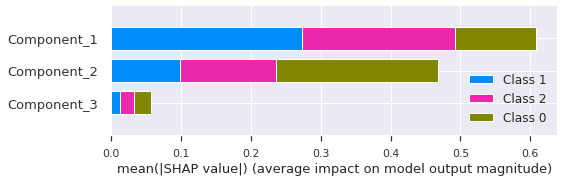

INFO:logs:Visual Rendered Successfully
INFO:logs:interpret_model() succesfully completed......................................


In [ ]:
interpret_model(tuned_rf_pca, plot='summary')

In [ ]:
#explainer = shap.TreeExplainer(tuned_rf_pca)
#X = df.drop('class', axis=1)
#shap_values = explainer.shap_values(X)
#shap.summary_plot(shap_values, X)

**Visualize a single prediction**

In [ ]:
interpret_model(tuned_rf_pca, plot='reason', observation=32)

INFO:logs:Initializing interpret_model()
INFO:logs:interpret_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='entropy',
                       max_depth=4, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0002,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       n_estimators=130, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False), use_train_data=False, X_new_sample=None, y_new_sample=None, feature=None, kwargs={}, observation=32, plot=reason, save=False)
INFO:logs:Checking exceptions
INFO:logs:plot type: reason
INFO:logs:model type detected: type 1
INFO:logs:Creating TreeExplainer
INFO:logs:Compiling shap values
INFO:logs:model type detected: Unknown


INFO:logs:Visual Rendered Successfully
INFO:logs:interpret_model() succesfully completed......................................


From the above the plot, we can seethe "base value," which is defined as the mean predicted target; and f(x), which is the prediction for a selected observation (i.e. observation number 32). The red-colored features increased the predicted value, while the blue-colored features decreased it. The size of each feature (i.e. Principal Component) indicates the impact it has on the model.

**Visualize many predictions**

In [ ]:
interpret_model(tuned_rf_pca, plot='reason')

INFO:logs:Initializing interpret_model()
INFO:logs:interpret_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='entropy',
                       max_depth=4, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0002,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       n_estimators=130, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False), use_train_data=False, X_new_sample=None, y_new_sample=None, feature=None, kwargs={}, observation=None, plot=reason, save=False)
INFO:logs:Checking exceptions
INFO:logs:plot type: reason
INFO:logs:model type detected: type 1
INFO:logs:Creating TreeExplainer
INFO:logs:Compiling shap values


INFO:logs:Visual Rendered Successfully
INFO:logs:interpret_model() succesfully completed......................................
